# Cleaning of PermitLog.xes

In [1]:
import pm4py
import matplotlib.pyplot as plt

In [2]:
# Load the XES file and convert it to a DataFrame
xes_filename = '../datasets/PermitLog.xes'
log = pm4py.read_xes(xes_filename)
df = pm4py.convert_to_dataframe(log)

df['case:id'] = df['case:id'].astype(str) #to reduce errors

df

parsing log, completed traces ::   0%|          | 0/7065 [00:00<?, ?it/s]

,id,org:resource,concept:name,time:timestamp,org:role,case:OrganizationalEntity,case:ProjectNumber,case:TaskNumber,case:dec_id_0,case:ActivityNumber,...,case:Cost Type_14,case:Cost Type_10,case:Cost Type_11,case:Cost Type_12,case:Task_5,case:Task_4,case:Task_9,case:Task_8,case:Task_7,case:Task_6
0,rv_travel permit 76455_6,STAFF MEMBER,Start trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,declaration 76457,activity 46005,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,rv_travel permit 76455_7,STAFF MEMBER,End trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,declaration 76457,activity 46005,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,st_step 76459_0,STAFF MEMBER,Permit SUBMITTED by EMPLOYEE,2017-04-06 13:32:10+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,declaration 76457,activity 46005,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,st_step 76460_0,STAFF MEMBER,Permit FINAL_APPROVED by SUPERVISOR,2017-04-06 13:32:28+00:00,SUPERVISOR,organizational unit 65458,UNKNOWN,UNKNOWN,declaration 76457,activity 46005,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,st_step 76461_0,STAFF MEMBER,Declaration SUBMITTED by EMPLOYEE,2017-04-07 13:38:14+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,declaration 76457,activity 46005,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86576,st_step 13113_0,STAFF MEMBER,Permit APPROVED by ADMINISTRATION,2018-12-30 15:11:51+00:00,ADMINISTRATION,organizational unit 65464,project 13110,task 427,NaN,UNKNOWN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86577,rv_travel permit 13108_6,STAFF MEMBER,Start trip,2019-01-02 00:00:00+00:00,EMPLOYEE,organizational unit 65464,project 13110,task 427,NaN,UNKNOWN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86578,st_step 13112_0,STAFF MEMBER,Permit APPROVED by SUPERVISOR,2019-01-02 09:11:23+00:00,SUPERVISOR,organizational unit 65464,project 13110,task 427,NaN,UNKNOWN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86579,st_step 13114_0,STAFF MEMBER,Permit FINAL_APPROVED by DIRECTOR,2019-01-07 14:03:29+00:00,DIRECTOR,organizational unit 65464,project 13110,task 427,NaN,UNKNOWN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
# Display the DataFrame information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86581 entries, 0 to 86580
Columns: 173 entries, id to case:Task_6
dtypes: bool(1), datetime64[ns, UTC](1), float64(18), object(153)
memory usage: 113.7+ MB


In [4]:
# Group by unique ids
unique_cases = df.groupby('case:id').size()

unique_cases

case:id
travel permit 10022    18
travel permit 10040    18
travel permit 10060     8
travel permit 10066    10
travel permit 10077    10
                       ..
travel permit 9931     10
travel permit 9942     10
travel permit 9953     12
travel permit 9965     18
travel permit 9984     38
Length: 7065, dtype: int64

In [5]:
# List the columns in the DataFrame
df.columns

Index(['id', 'org:resource', 'concept:name', 'time:timestamp', 'org:role',
       'case:OrganizationalEntity', 'case:ProjectNumber', 'case:TaskNumber',
       'case:dec_id_0', 'case:ActivityNumber',
       ...
       'case:Cost Type_14', 'case:Cost Type_10', 'case:Cost Type_11',
       'case:Cost Type_12', 'case:Task_5', 'case:Task_4', 'case:Task_9',
       'case:Task_8', 'case:Task_7', 'case:Task_6'],
      dtype='object', length=173)

In [6]:
# Number of columns in the DataFrame
df.shape[1]

173

In [29]:
# Count NaN values in each column and calculate their percentage
nan_counts = df.isnull().sum()
total_rows = len(df)
nan_percentages = (nan_counts / total_rows) * 100
print("NaN percentage for each column:\n")
print(nan_percentages)

# Identify columns with at least 10% NaN values
columns_with_high_nan = nan_percentages[nan_percentages >= 10]
print("\nColumns with at least 10% NaN values:", len(columns_with_high_nan))

# Drop those columns from the DataFrame
columns_to_drop = columns_with_high_nan.index.tolist()
filtered_df = df.drop(columns=columns_to_drop)

filtered_df

NaN percentage for each column:

id                  0.000000
org:resource        0.000000
concept:name        0.000000
time:timestamp      0.000000
org:role            0.000000
                     ...    
case:Task_9        99.816357
case:Task_8        99.816357
case:Task_7        99.816357
case:Task_6        99.816357
start_timestamp     0.000000
Length: 174, dtype: float64

Columns with at least 10% NaN values: 155


,id,org:resource,concept:name,time:timestamp,org:role,case:OrganizationalEntity,case:ProjectNumber,case:TaskNumber,case:ActivityNumber,case:TotalDeclared,case:concept:name,case:RequestedAmount_0,case:Overspent,case:travel permit number,case:id,case:RequestedBudget,case:BudgetNumber,case:OverspentAmount,start_timestamp
0,rv_travel permit 76455_6,STAFF MEMBER,Start trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,activity 46005,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000,2016-10-05 00:00:00+00:00
1,rv_travel permit 76455_7,STAFF MEMBER,End trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,activity 46005,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000,2016-10-05 00:00:00+00:00
2,st_step 76459_0,STAFF MEMBER,Permit SUBMITTED by EMPLOYEE,2017-04-06 13:32:10+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,activity 46005,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000,2017-04-06 13:32:10+00:00
3,st_step 76460_0,STAFF MEMBER,Permit FINAL_APPROVED by SUPERVISOR,2017-04-06 13:32:28+00:00,SUPERVISOR,organizational unit 65458,UNKNOWN,UNKNOWN,activity 46005,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000,2017-04-06 13:32:28+00:00
4,st_step 76461_0,STAFF MEMBER,Declaration SUBMITTED by EMPLOYEE,2017-04-07 13:38:14+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,activity 46005,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000,2017-04-07 13:38:14+00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86576,st_step 13113_0,STAFF MEMBER,Permit APPROVED by ADMINISTRATION,2018-12-30 15:11:51+00:00,ADMINISTRATION,organizational unit 65464,project 13110,task 427,UNKNOWN,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966,2018-12-30 15:11:51+00:00
86577,rv_travel permit 13108_6,STAFF MEMBER,Start trip,2019-01-02 00:00:00+00:00,EMPLOYEE,organizational unit 65464,project 13110,task 427,UNKNOWN,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966,2019-01-02 00:00:00+00:00
86578,st_step 13112_0,STAFF MEMBER,Permit APPROVED by SUPERVISOR,2019-01-02 09:11:23+00:00,SUPERVISOR,organizational unit 65464,project 13110,task 427,UNKNOWN,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966,2019-01-02 09:11:23+00:00
86579,st_step 13114_0,STAFF MEMBER,Permit FINAL_APPROVED by DIRECTOR,2019-01-07 14:03:29+00:00,DIRECTOR,organizational unit 65464,project 13110,task 427,UNKNOWN,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966,2019-01-07 14:03:29+00:00


In [8]:
# Count 'UNKNOWN' values in each column of the filtered DataFrame and their percentages
unknown_counts = filtered_df.astype(str).apply(lambda col: col.str.count('UNKNOWN').sum())
columns_with_unknown = unknown_counts[unknown_counts > 0]
total_rows = len(filtered_df)
unknown_percentages = (columns_with_unknown / total_rows) * 100

print(unknown_percentages)

case:ProjectNumber           40.708701
case:TaskNumber              40.827664
case:ActivityNumber          92.880655
case:travel permit number     1.200032
dtype: float64


In [ ]:
# Drop columns with lots of 'UNKNOWN' values
filtered_df = filtered_df.drop(columns=["case:ActivityNumber"])

filtered_df

,id,org:resource,concept:name,time:timestamp,org:role,case:OrganizationalEntity,case:ProjectNumber,case:TaskNumber,case:TotalDeclared,case:concept:name,case:RequestedAmount_0,case:Overspent,case:travel permit number,case:id,case:RequestedBudget,case:BudgetNumber,case:OverspentAmount
0,rv_travel permit 76455_6,STAFF MEMBER,Start trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000
1,rv_travel permit 76455_7,STAFF MEMBER,End trip,2016-10-05 00:00:00+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000
2,st_step 76459_0,STAFF MEMBER,Permit SUBMITTED by EMPLOYEE,2017-04-06 13:32:10+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000
3,st_step 76460_0,STAFF MEMBER,Permit FINAL_APPROVED by SUPERVISOR,2017-04-06 13:32:28+00:00,SUPERVISOR,organizational unit 65458,UNKNOWN,UNKNOWN,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000
4,st_step 76461_0,STAFF MEMBER,Declaration SUBMITTED by EMPLOYEE,2017-04-07 13:38:14+00:00,EMPLOYEE,organizational unit 65458,UNKNOWN,UNKNOWN,39.664561,travel permit 76455,56,False,travel permit number 76456,travel permit 76455,41.613445,budget 922,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86576,st_step 13113_0,STAFF MEMBER,Permit APPROVED by ADMINISTRATION,2018-12-30 15:11:51+00:00,ADMINISTRATION,organizational unit 65464,project 13110,task 427,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966
86577,rv_travel permit 13108_6,STAFF MEMBER,Start trip,2019-01-02 00:00:00+00:00,EMPLOYEE,organizational unit 65464,project 13110,task 427,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966
86578,st_step 13112_0,STAFF MEMBER,Permit APPROVED by SUPERVISOR,2019-01-02 09:11:23+00:00,SUPERVISOR,organizational unit 65464,project 13110,task 427,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966
86579,st_step 13114_0,STAFF MEMBER,Permit FINAL_APPROVED by DIRECTOR,2019-01-07 14:03:29+00:00,DIRECTOR,organizational unit 65464,project 13110,task 427,0.000000,travel permit 13108,NaN,False,travel permit number 13109,travel permit 13108,2830.993162,budget 5650,-2709.667966


In [10]:
negative_overspent_count = filtered_df[filtered_df['case:OverspentAmount'] < 0].shape[0]

print(f"Numero di righe con 'case:OverspentAmount' negativo: {negative_overspent_count}")

Numero di righe con 'case:OverspentAmount' negativo: 55762


In [ ]:
# Compute variants paths and their durations

variants_df = pm4py.get_variants_paths_duration(
    df,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

# Dataframe with sorting of the variants
variants = variants_df.groupby('@@variant_column').agg({'@@variant_count': 'first'}).reset_index()

# Sorting the DataFrame by '@@variant_count' column in descending order
variants = variants.sort_values(by='@@variant_count', ascending=False).reset_index(drop=True) # This resets the index after sorting. drop=True ensures the old index is not added as a new column.

len(variants)

1478

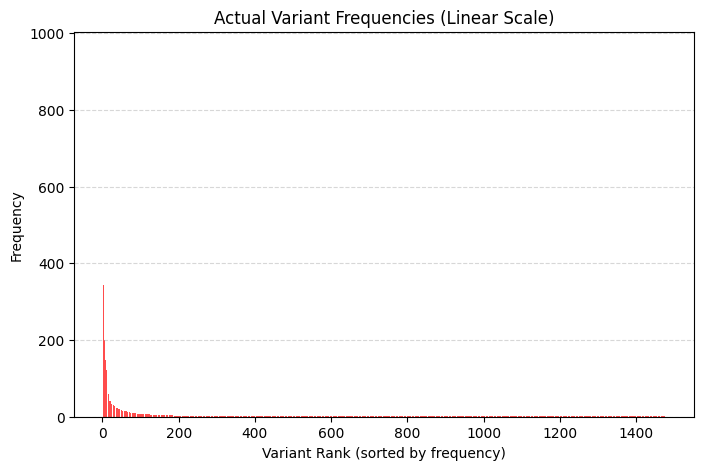

In [12]:
# Create a variable for the distribution 
distribution = variants['@@variant_count']

# Raw Frequency Plot (Linear Scale)
plt.figure(figsize=(8, 5))
plt.bar(range(1, len(distribution)+1), distribution, color='red', alpha=0.7)
plt.title("Actual Variant Frequencies (Linear Scale)")
plt.xlabel("Variant Rank (sorted by frequency)")
plt.ylabel("Frequency")
plt.grid(True, axis='y', ls="--", alpha=0.5)
plt.show()

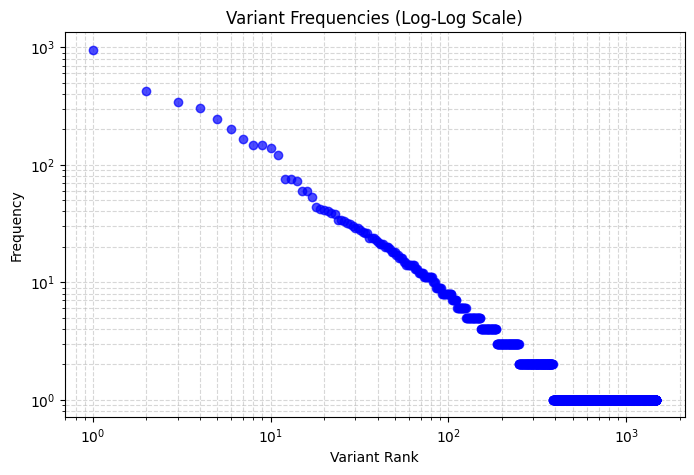

In [13]:
# Log-Log Plot
plt.figure(figsize=(8, 5))
plt.loglog(range(1, len(distribution)+1), distribution, 'bo', alpha=0.7)
plt.title("Variant Frequencies (Log-Log Scale)")
plt.xlabel("Variant Rank")
plt.ylabel("Frequency")
plt.grid(True, which="both", ls="--", alpha=0.5)
plt.show()

In [ ]:
# Display the top N variants
top_n = 50
print(top_n, " more frequent variants")
print(variants.head(top_n))

# Evaluate the coverage of the top N variants
total_cases = variants['@@variant_count'].sum()
cases_in_top_n = variants['@@variant_count'].head(top_n).sum()
percentage_coverage = (cases_in_top_n / total_cases) * 100
print(f"\nTop {top_n} variants cover {percentage_coverage:.2f}% of total cases")

50  more frequent variants
                                     @@variant_column  @@variant_count
0   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              956
1   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              427
2   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              343
3   (Permit SUBMITTED by EMPLOYEE, Permit FINAL_AP...              302
4   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              243
5   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              201
6   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              166
7   (Start trip, End trip, Permit SUBMITTED by EMP...              148
8   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              147
9   (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              138
10  (Permit SUBMITTED by EMPLOYEE, Permit APPROVED...              121
11  (Permit SUBMITTED by EMPLOYEE, Permit FINAL_AP...               75
12  (Permit SUBMITTED by EMPLOYEE, Permit APPROVED

In [15]:
# Add a new DataFrame to store the durations of each case
filtered_df_dur = filtered_df.copy()

# Min and Max Timestamps for Case Durations
min_timestamps = filtered_df_dur.groupby('case:id')['time:timestamp'].min()
max_timestamps = filtered_df_dur.groupby('case:id')['time:timestamp'].max()

# Case Durations as Timedelta and convert to seconds
case_durations_timedelta = max_timestamps - min_timestamps
case_durations_seconds = case_durations_timedelta.dt.total_seconds()

# Mapping, conversion and new columns
filtered_df_dur.loc[:, 'case_duration_seconds'] = filtered_df_dur['case:id'].map(case_durations_seconds)
filtered_df_dur.loc[:, 'case_duration_minutes'] = filtered_df_dur['case_duration_seconds'] / 60
filtered_df_dur.loc[:, 'case_duration_hours'] = filtered_df_dur['case_duration_seconds'] / 3600
filtered_df_dur.loc[:, 'case_duration_days'] = filtered_df_dur['case_duration_seconds'] / (24 * 3600)

# Statistics for case durations
print(f"Mean duration (days): {filtered_df_dur['case_duration_days'].mean():.2f}")
print(f"Median duration (days): {filtered_df_dur['case_duration_days'].median():.2f}")
print(f"Max duration (days): {filtered_df_dur['case_duration_days'].max():.2f}")
print(f"Min duration (days): {filtered_df_dur['case_duration_days'].min():.2f}")
print(f"N° of Nan created: {filtered_df_dur['case_duration_seconds'].isna().sum()}")

Mean duration (days): 90.05
Median duration (days): 76.07
Max duration (days): 1190.33
Min duration (days): 0.53
N° of Nan created: 0


In [16]:
# Find the number of cases with zero duration
zero_duration_cases_count = (filtered_df_dur['case_duration_seconds'] == 0).sum()

print(f"Number of cases with zero duration (seconds): {zero_duration_cases_count}")

Number of cases with zero duration (seconds): 0


In [ ]:
# Get the start activities of the cases

start_activities = pm4py.get_start_activities(
    filtered_df_dur,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

start_activities

{'Start trip': 734,
 'Permit SUBMITTED by EMPLOYEE': 6319,
 'Permit SAVED by EMPLOYEE': 12}

In [ ]:
# Filter out specific start activities that are not relevant for analysis

activities_to_exclude = ['Permit SAVED by EMPLOYEE']

filtered_df_dur = pm4py.filter_start_activities(
    filtered_df_dur,
    activities_to_exclude,
    retain=False,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

start_activities = pm4py.get_start_activities(
    filtered_df_dur,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

start_activities

{'Start trip': 734, 'Permit SUBMITTED by EMPLOYEE': 6319}

In [19]:
# Get the end activities of the cases

end_activities = pm4py.get_end_activities(
    filtered_df_dur,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

end_activities

{'Payment Handled': 5474,
 'Permit SAVED by EMPLOYEE': 4,
 'Declaration SAVED by EMPLOYEE': 28,
 'Send Reminder': 990,
 'Permit REJECTED by MISSING': 38,
 'End trip': 442,
 'Declaration REJECTED by MISSING': 2,
 'Declaration REJECTED by EMPLOYEE': 28,
 'Permit REJECTED by EMPLOYEE': 31,
 'Permit FINAL_APPROVED by SUPERVISOR': 14,
 'Request Payment': 1,
 'Declaration REJECTED by SUPERVISOR': 1}

In [20]:
# Filter out specific end activities that are not relevant for analysis

activities_to_exclude = ['Permit SAVED by EMPLOYEE', 'Declaration SAVED by EMPLOYEE', 'Permit FINAL_APPROVED by SUPERVISOR', 'Request Payment', 'Declaration REJECTED by MISSING', 'Declaration REJECTED by EMPLOYEE', 'Declaration REJECTED by SUPERVISOR']

filtered_df_dur = pm4py.filter_end_activities(
    filtered_df_dur,
    activities_to_exclude,
    retain=False,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

end_activities = pm4py.get_end_activities(
    filtered_df_dur,
    activity_key='concept:name',
    case_id_key='case:id',
    timestamp_key='time:timestamp'
)

end_activities

{'Payment Handled': 5474,
 'Send Reminder': 990,
 'Permit REJECTED by MISSING': 38,
 'End trip': 442,
 'Permit REJECTED by EMPLOYEE': 31}

In [21]:
# Compute frequency of activities
activity_counts = filtered_df_dur["concept:name"].value_counts().sort_values(ascending=True)
print("Frequency of Activities:\n", activity_counts)

Frequency of Activities:
 concept:name
Permit FOR_APPROVAL by SUPERVISOR                      1
Permit SAVED by EMPLOYEE                               1
Permit FOR_APPROVAL by ADMINISTRATION                  1
Permit REJECTED by DIRECTOR                            2
Declaration REJECTED by DIRECTOR                       3
Request For Payment REJECTED by BUDGET OWNER           6
Request For Payment REJECTED by MISSING                7
Request For Payment SAVED by EMPLOYEE                 17
Request For Payment REJECTED by PRE_APPROVER          17
Request For Payment REJECTED by SUPERVISOR            20
Permit REJECTED by PRE_APPROVER                       33
Declaration SAVED by EMPLOYEE                         36
Request For Payment APPROVED by SUPERVISOR            37
Request For Payment FINAL_APPROVED by DIRECTOR        37
Declaration REJECTED by BUDGET OWNER                  38
Permit REJECTED by BUDGET OWNER                       54
Declaration REJECTED by PRE_APPROVER             

In [22]:
# Filter out activities that are not relevant for analysis based on their frequency

# Identify activities that are rare (frequency < 1000)
rare_activities_to_remove_cases = activity_counts[activity_counts < 1000].index.tolist()
print(f"Number of activities considered 'rare' (frequency < 1000): {len(rare_activities_to_remove_cases)}")

# Find all 'case:id's that contain at least one of these rare activities
cases_with_rare_activities_events = filtered_df_dur[
    filtered_df_dur['concept:name'].isin(rare_activities_to_remove_cases)
]

# Extract the unique 'case:id's from these cases
case_ids_to_remove = cases_with_rare_activities_events['case:id'].unique()
print(f"\nNumber of cases that will be removed: {len(case_ids_to_remove)}")

# Filter the DataFrame to remove all rows corresponding to these cases, creating a new DataFrame
filtered_df_cases_by_activities = filtered_df_dur[
    ~filtered_df_dur['case:id'].isin(case_ids_to_remove) # ~ negates the condition to keep only those cases not in the list
].copy()

print(f"\nOriginal DataFrame rows: {len(filtered_df_dur)}")
print(f"Filtered DataFrame rows: {len(filtered_df_cases_by_activities)}")
print(f"Number of unique cases in original DataFrame: {filtered_df_dur['case:id'].nunique()}")
print(f"Number of unique cases in filtered DataFrame: {filtered_df_cases_by_activities['case:id'].nunique()}")

Number of activities considered 'rare' (frequency < 1000): 33

Number of cases that will be removed: 2142

Original DataFrame rows: 85796
Filtered DataFrame rows: 53251
Number of unique cases in original DataFrame: 6975
Number of unique cases in filtered DataFrame: 4833


In [23]:
# Create a copy of the filtered DataFrame for further analysis

df_cleaned = filtered_df_cases_by_activities.copy()

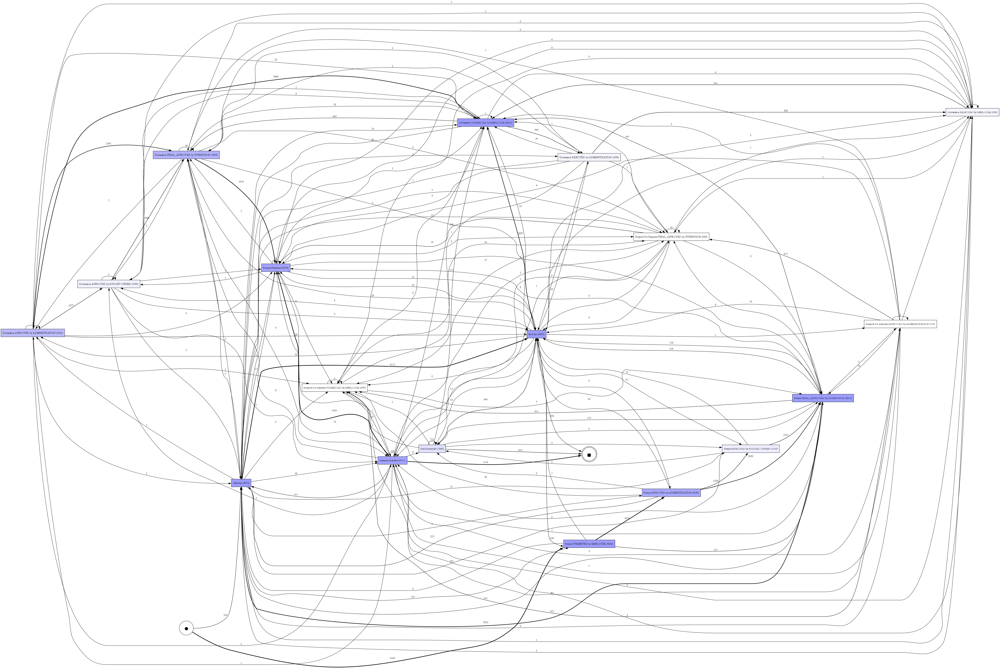

In [ ]:
# Directly Follows Graph (DFG)

# Create graph from original DF and visualise it
dfg, start_activities, end_activities = pm4py.discover_dfg(df)
pm4py.view_dfg(dfg, start_activities, end_activities)

# Create graph from filtered DF and visualise it
dfg, start_activities, end_activities = pm4py.discover_dfg(df_cleaned)
pm4py.view_dfg(dfg, start_activities, end_activities)

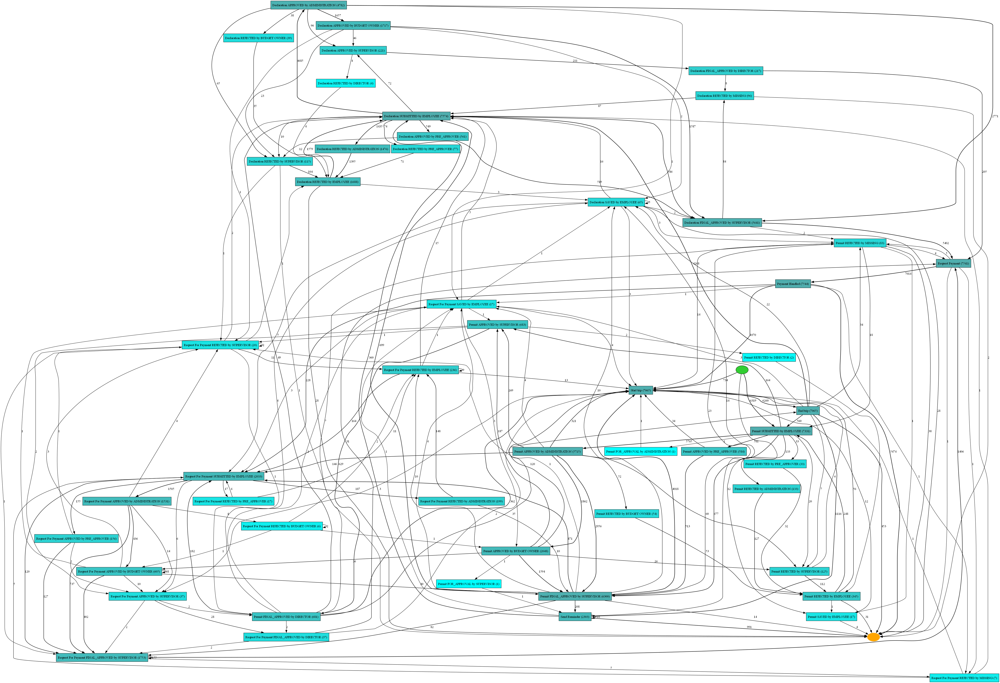

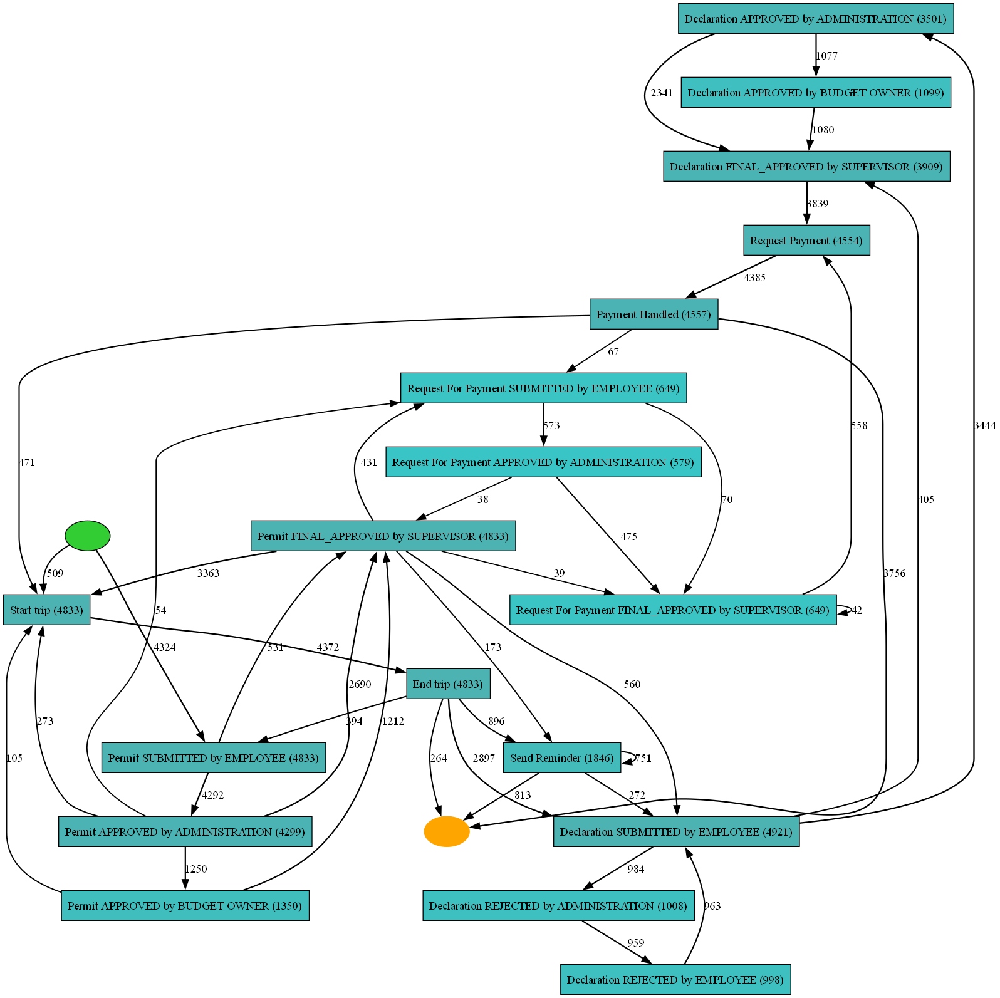

In [ ]:
# Heuristic Miner (HM)

# Discover the HM-map of the original DF and visualise it
map = pm4py.discover_heuristics_net(df)
pm4py.view_heuristics_net(map)

# Discover the HM-map of the filtered DF and visualise it
map = pm4py.discover_heuristics_net(df_cleaned)
pm4py.view_heuristics_net(map)

In [26]:
# Export the cleaned DataFrame to an XES file

"""
log_name_for_file = "PermitLog_cleaned.xes"
log = pm4py.convert_to_event_log(df_cleaned,
                                 case_id_key='case:id',
                                 activity_key='concept:name',
                                 timestamp_key='time:timestamp')

pm4py.write_xes(log, log_name_for_file)

print(f"Log succesfully exported in: {log_name_for_file}")
"""

'\nlog_name_for_file = "PermitLog_cleaned.xes"\nlog = pm4py.convert_to_event_log(df_cleaned,\n                                 case_id_key=\'case:id\',\n                                 activity_key=\'concept:name\',\n                                 timestamp_key=\'time:timestamp\')\n\npm4py.write_xes(log, log_name_for_file)\n\nprint(f"Log succesfully exported in: {log_name_for_file}")\n'